라이브러리 임포트 및 설정

In [1]:
# Cell 1: Import Libraries
import numpy as np
import open3d as o3d
import cv2
import matplotlib.pyplot as plt
import glob
import os

# Calibration 파일을 읽는 함수
def read_calib_file(file_path):
    with open(file_path, 'r') as f:
        lines = f.readlines()

    P2 = np.array([float(i) for i in lines[2].split(' ')[1:]]).reshape(3,4)
    R0_rect = np.array([float(i) for i in lines[4].split(' ')[1:]]).reshape(3,3)
    Tr_velo_to_cam = np.array([float(i) for i in lines[5].split(' ')[1:]]).reshape(3,4)

    return P2, R0_rect, Tr_velo_to_cam



Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


데이터 변환 및 시각화 함수 정의

In [2]:
# Cell 2: Define Transformation and Visualization Functions

# LiDAR 데이터를 이미지 좌표로 변환하는 함수
def transform_lidar_to_image(data, P2, R0_rect, Tr_velo_to_cam):
    R0 = np.eye(4)
    R0[:3, :3] = R0_rect
    Tr = np.vstack([Tr_velo_to_cam, [0, 0, 0, 1]])

    # LiDAR 데이터 변환
    XYZ1 = np.vstack([data[:, :3].T, np.ones((1, data.shape[0]))])
    xyz = np.dot(P2, np.dot(R0, np.dot(Tr, XYZ1)))
    
    # z축을 기준으로 mask 생성
    z = xyz[2, :]
    mask = z > 0
    x = (xyz[0, mask] / z[mask]).astype(np.int32)
    y = (xyz[1, mask] / z[mask]).astype(np.int32)
    
    return x, y, mask

# 이미지와 변환된 포인트 클라우드 데이터 시각화
def visualization_plt(image_file, data, x, y):
    img = cv2.imread(image_file)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    aspect_ratio = float(img.shape[1]) / img.shape[0]

    fig, axs = plt.subplots(1, 2, figsize=(20, 25))

    axs[0].imshow(img_rgb)
    axs[0].axis('off')

    x_values = data[:, 0]
    x_min, x_max = np.percentile(x_values, 1), np.percentile(x_values, 99)

    scatter = axs[1].scatter(x, img.shape[0] - y, c=x_values, cmap='jet', marker='.', s=15, vmin=x_min, vmax=x_max)
    axs[1].set_xlim([0, img.shape[1]])
    axs[1].set_ylim([0, img.shape[0]])
    axs[1].axis('off')

    for ax in axs:
        ax.set_aspect(aspect_ratio)

    plt.tight_layout()
    plt.show()



경로 설정 및 파일 처리

Visualizing file: 000000


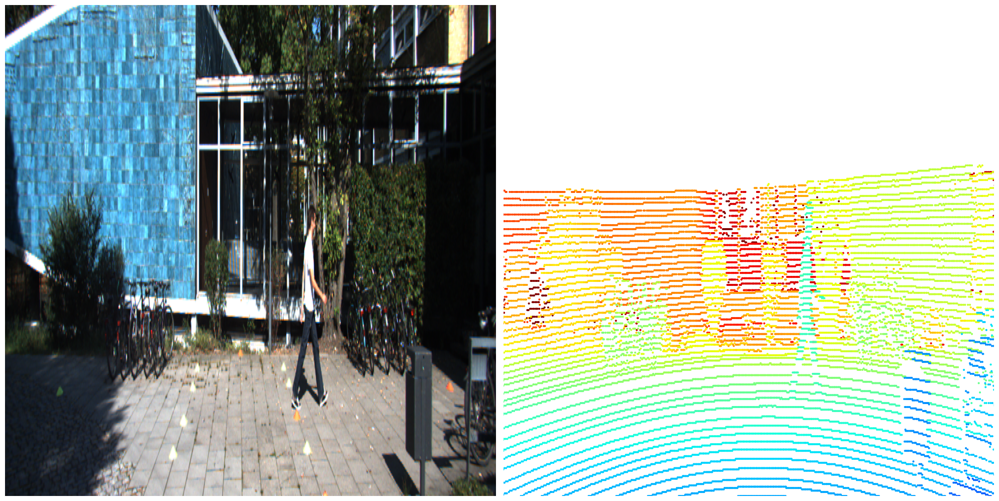

Visualizing file: 000001


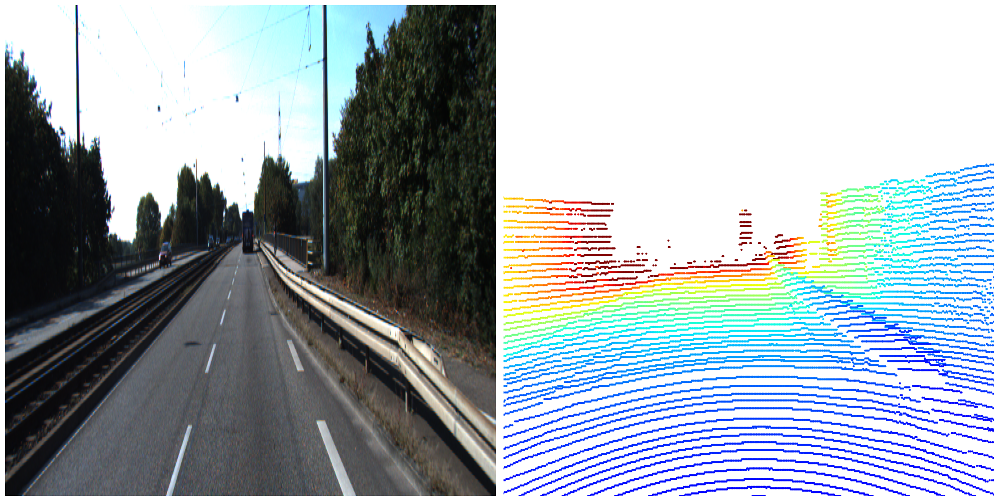

Visualizing file: 000001


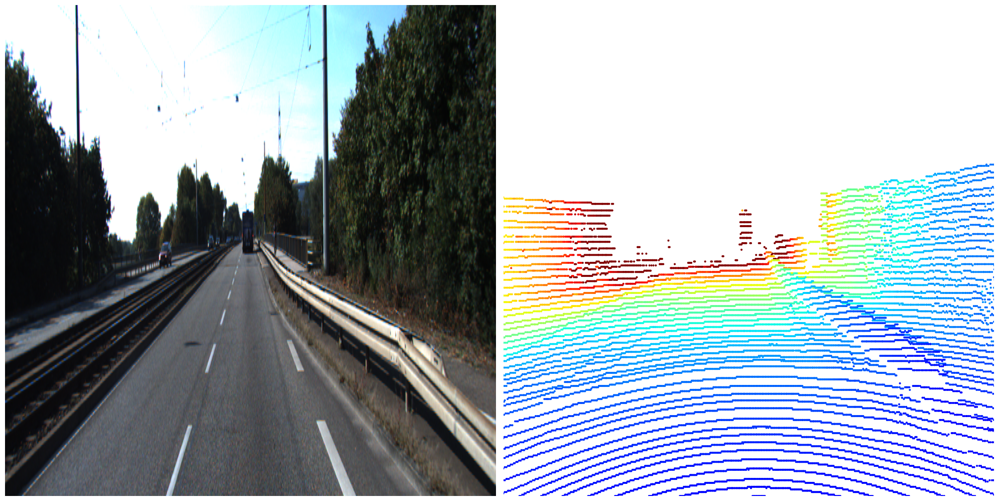

Visualizing file: 000001


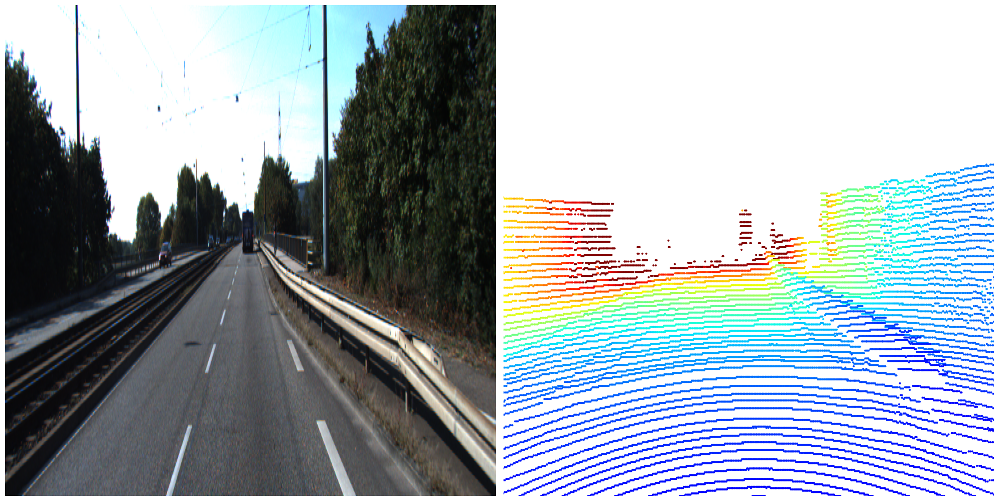

Visualizing file: 000002


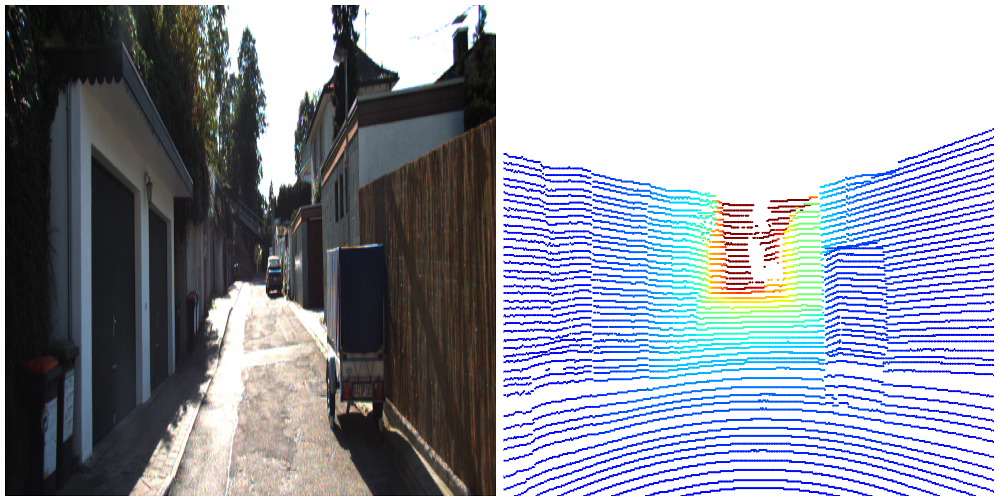

Visualizing file: 000002


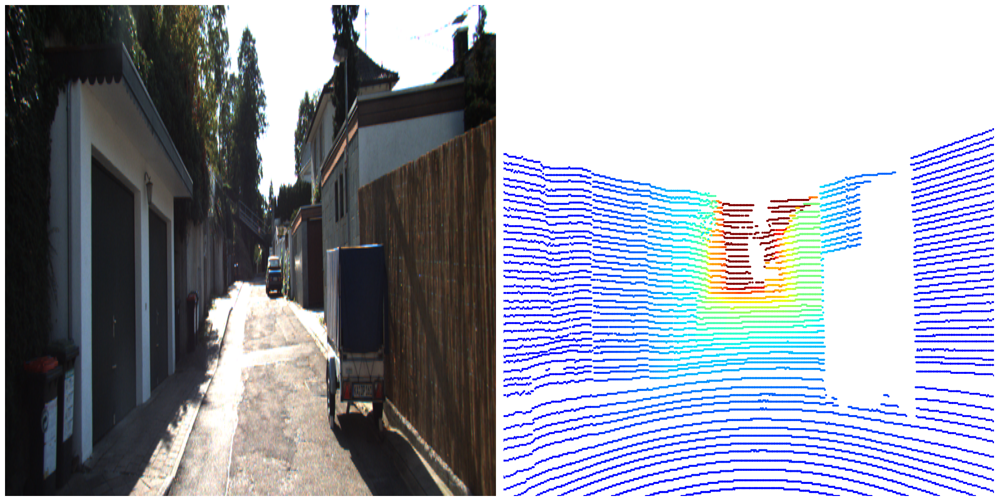

Visualizing file: 000003


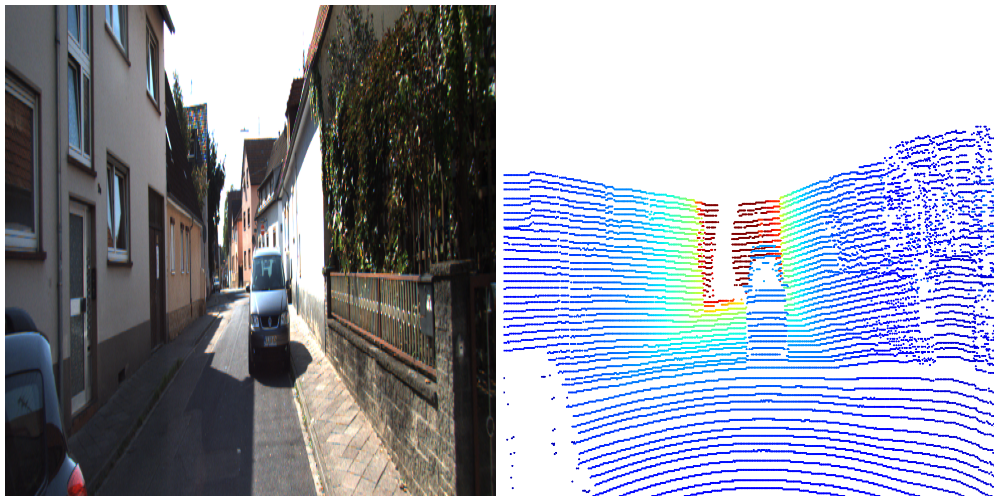

Visualizing file: 000004


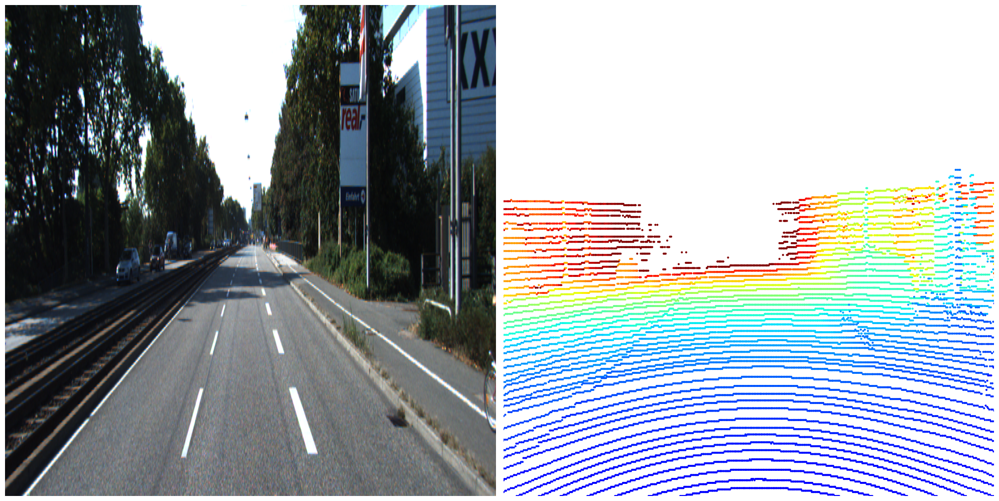

Visualizing file: 000004


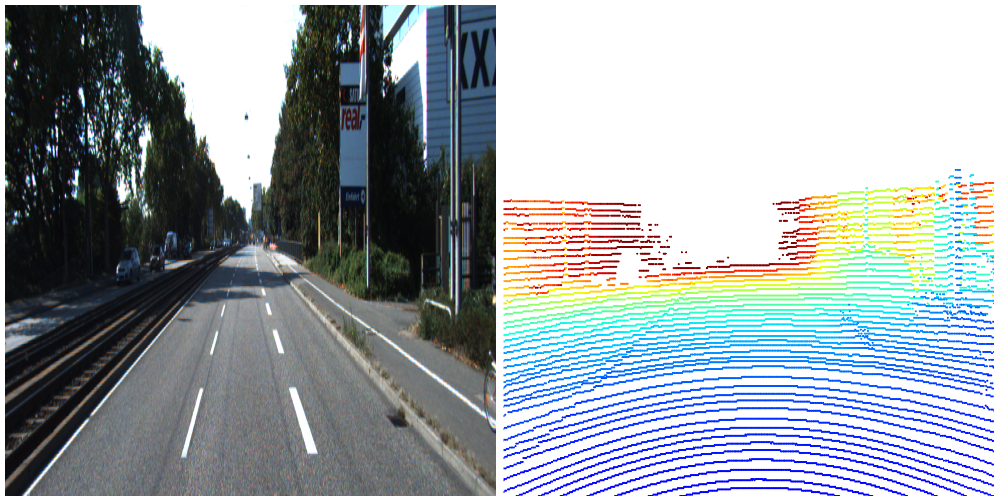

Visualizing file: 000005


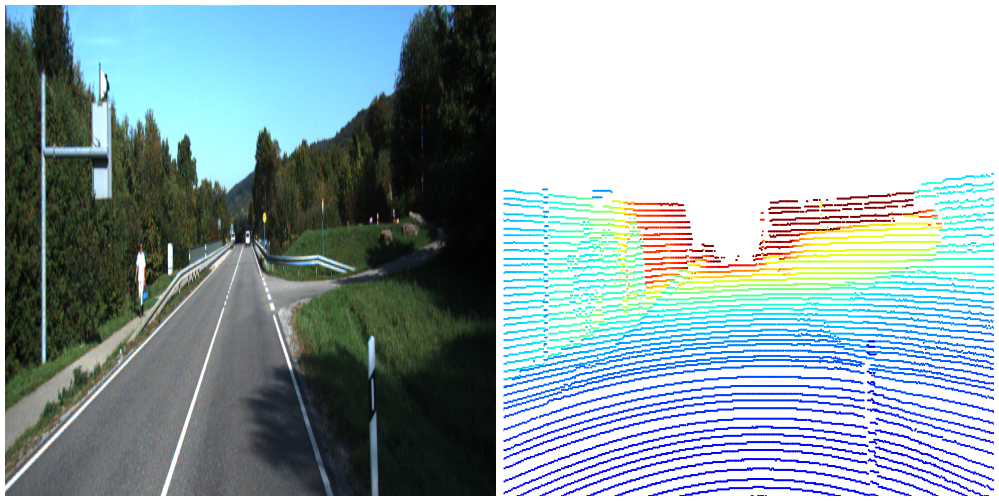

Visualizing file: 000006


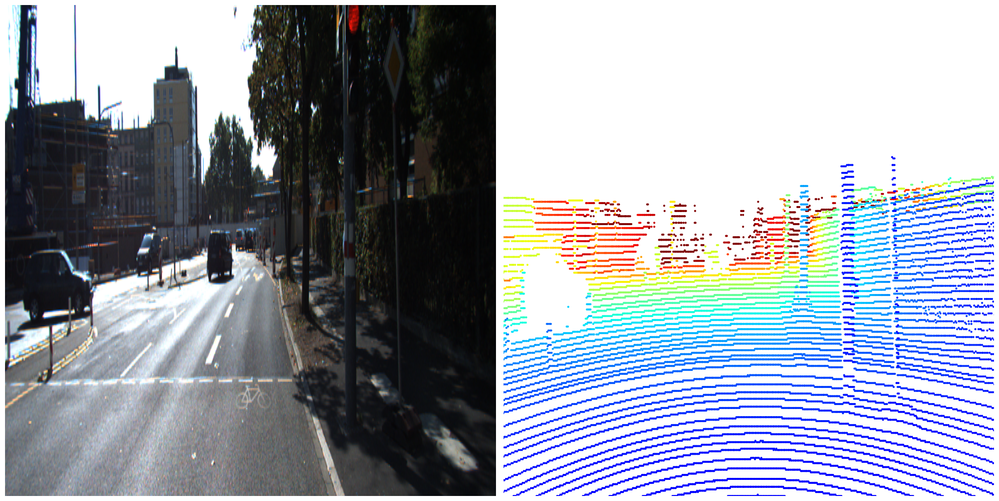

Visualizing file: 000006


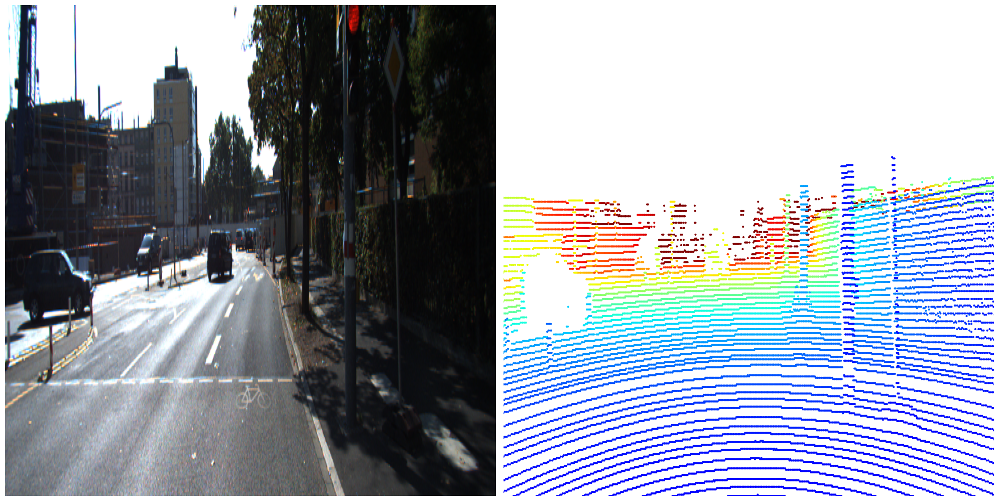

Visualizing file: 000006


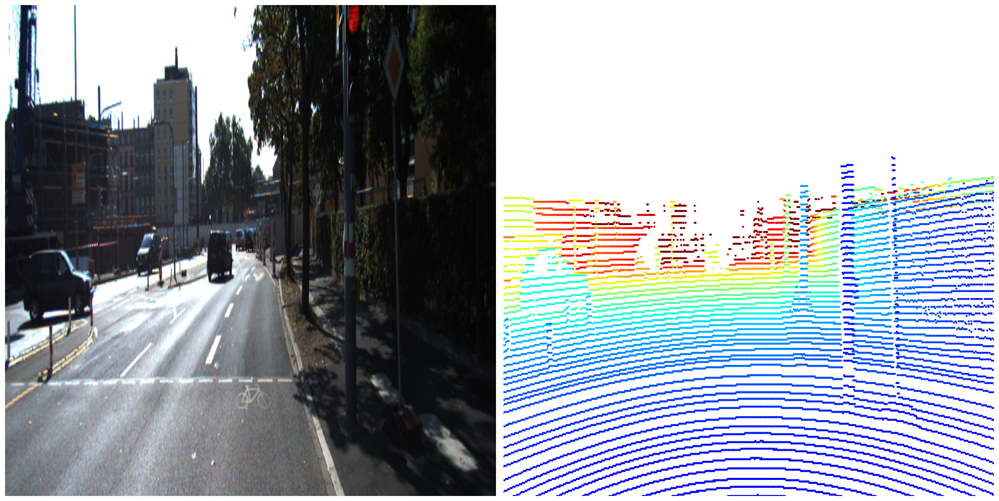

Visualizing file: 000006


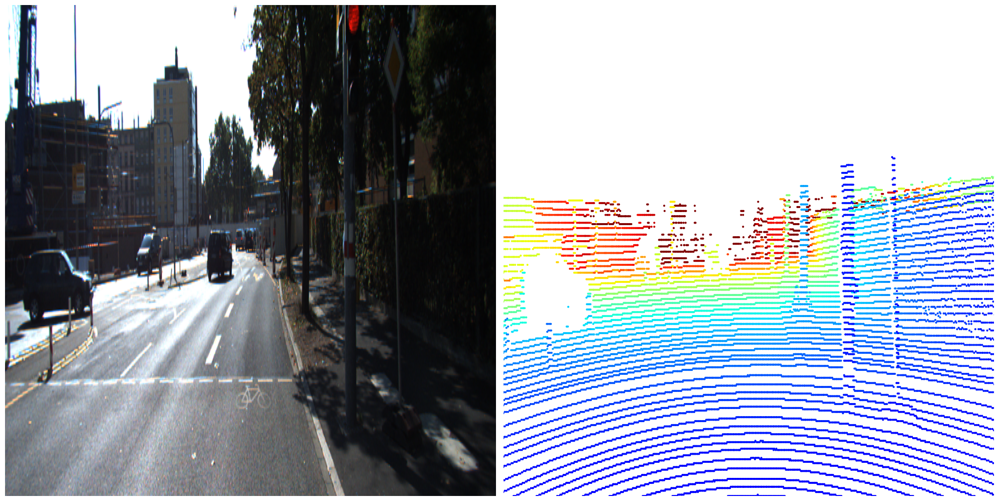

Visualizing file: 000007


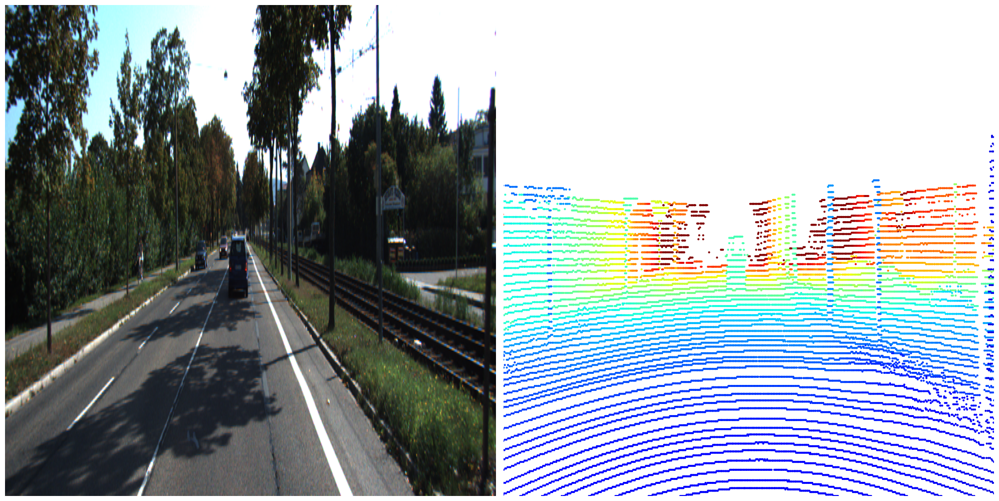

Visualizing file: 000007


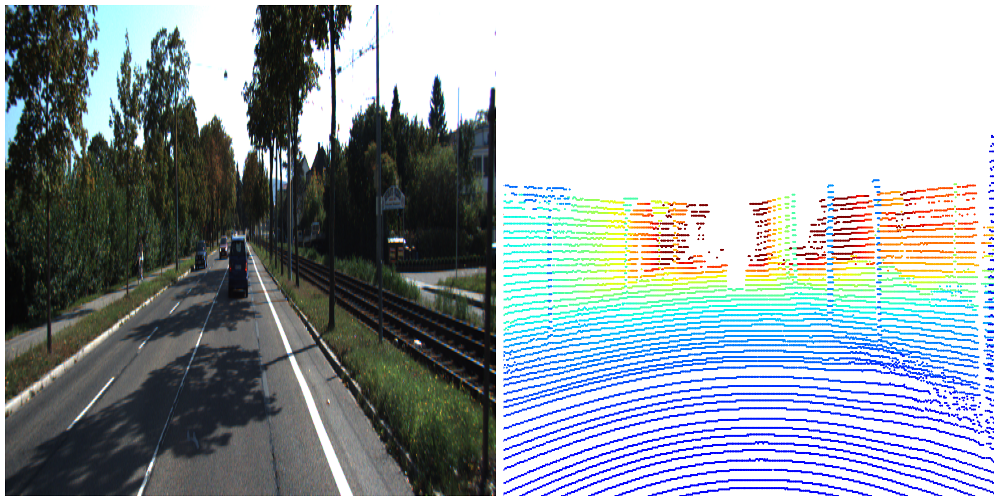

Visualizing file: 000007


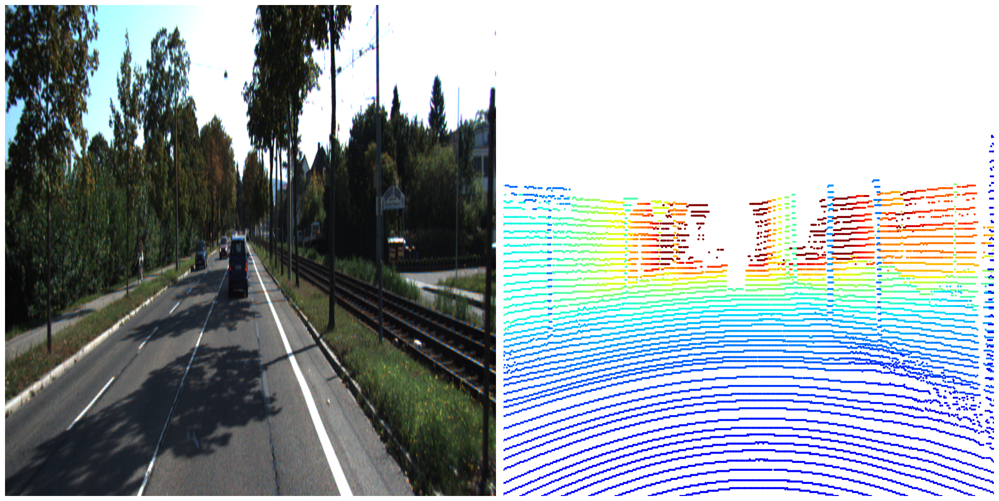

Visualizing file: 000007


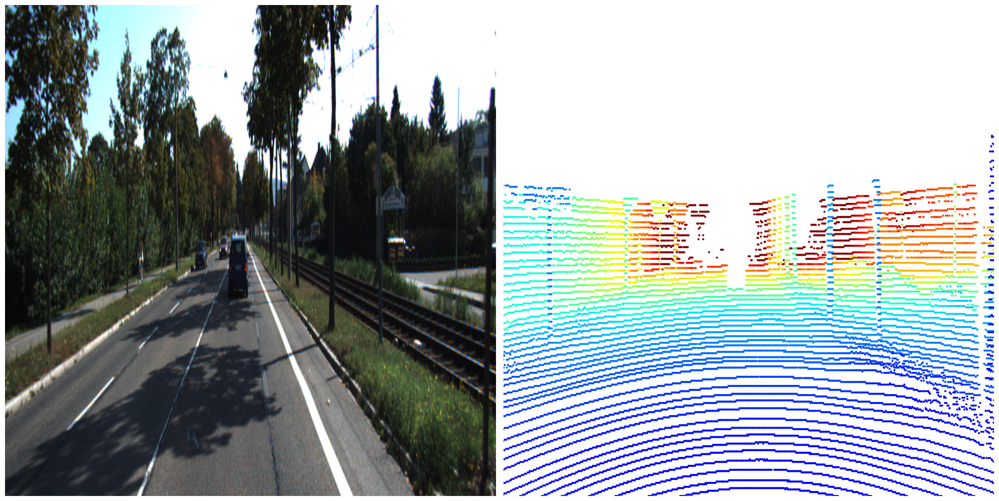

Visualizing file: 000008


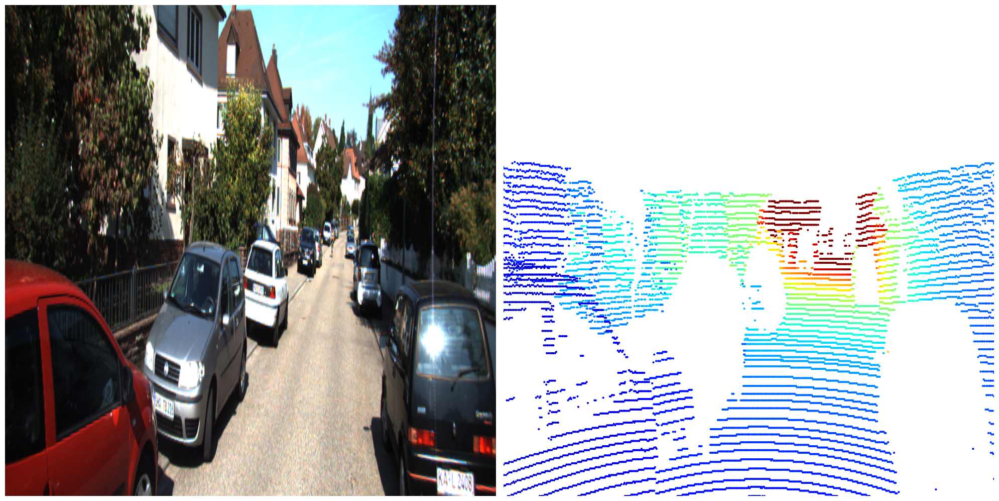

Visualizing file: 000008


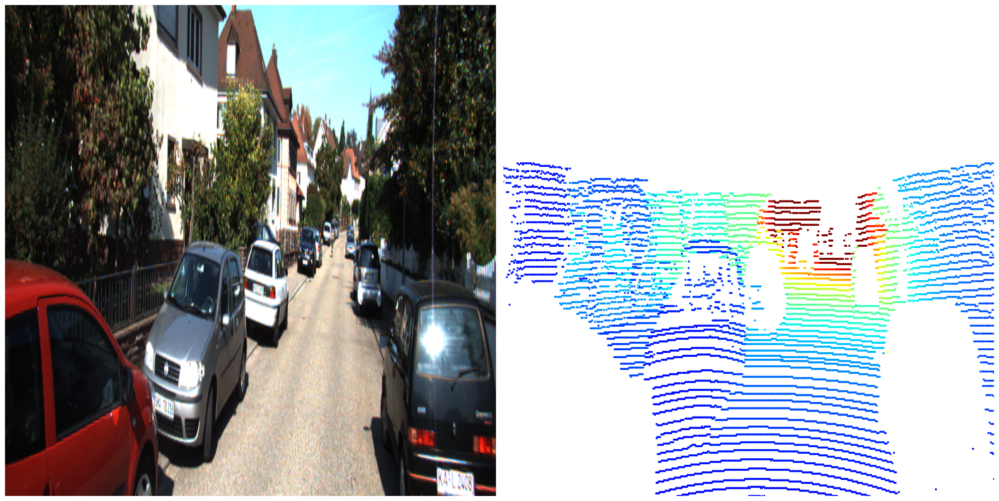

In [3]:
# Cell 3: Set File Paths and Process Files

# 파일 경로 설정
velo_dir = '/media/ssd3/lab/jojeon/KITTI/data_spoofing/velodyne'
image_dir = '/media/ssd3/lab/sypark/KITTI/object/2d_object/data_object_image_2/training/image_2'
label_dir = '/media/ssd3/lab/sypark/KITTI/object/2d_object/data_object_label_2/training/label_2'
calib_dir = '/media/ssd3/lab/sypark/KITTI/object/2d_object/data_object_calib/training/calib'

# 첫 20개 파일만 선택
velo_files = sorted(glob.glob(os.path.join(velo_dir, '*.bin')))[:20]

# 각 파일에 대해 변환 수행 및 시각화
# 각 파일에 대해 변환 수행 및 시각화
for velo_file in velo_files:
    # 파일 이름에서 숫자 6자리 추출 (예: "000000" from "000000-1.bin")
    file_name = os.path.basename(velo_file).split('-')[0]
    
    # 해당 파일에 대한 calib, image, label 파일 경로 설정
    label_file = os.path.join(label_dir, f"{file_name}.txt")
    calib_file = os.path.join(calib_dir, f"{file_name}.txt")
    image_file = os.path.join(image_dir, f"{file_name}.png")

    # Calibration 파일 로드
    P2, R0_rect, Tr_velo_to_cam = read_calib_file(calib_file)

    # LiDAR 데이터 로드
    with open(velo_file, 'rb') as f:
        data = np.fromfile(f, dtype=np.float32).reshape(-1,4)

    # LiDAR 데이터를 이미지 좌표로 변환
    x, y, mask = transform_lidar_to_image(data, P2, R0_rect, Tr_velo_to_cam)
    
    # Mask를 적용하여 필터링된 데이터 생성
    filtered_data = data[mask]

    # 시각화
    print(f"Visualizing file: {file_name}")
    visualization_plt(image_file, filtered_data, x, y)